In [1]:
!pip install pydrive

## Authenticate Colab and Get Fish Data

In [183]:
# Import PyDrive and associated libraries.
# This only needs to be done once per notebook.
from pydrive2.auth import GoogleAuth
from pydrive2.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

# Authenticate and create the PyDrive client.
# This only needs to be done once per notebook.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

# Download a file based on its file ID.
#
# A file ID looks like: laggVyWshwcyP6kEI-y_W3P8D26sz

#link: https://drive.google.com/file/d/1_MIr11KGN5tJHsxh-kaB09mMuri8yqNz/view?usp=sharing

file_id = "1_5AdAjK90Clz6W6aFzpb-PEenNpNrvk4"
downloaded = drive.CreateFile({'id': file_id})
downloaded.GetContentFile('fish_data2.csv')

In [184]:
!pip install category_encoders

## Import relevant libraries

In [185]:
import warnings
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from numpy import mean,std
import category_encoders as ce
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import SVR
from sklearn.ensemble import BaggingRegressor,AdaBoostRegressor, VotingRegressor
from sklearn.metrics import mean_squared_error, r2_score, explained_variance_score
from sklearn.model_selection import train_test_split, cross_val_score, RepeatedKFold, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler


# RMSE: lower values are good, while high values are worst.
# R2; Best possible score is 1.0 and it can be negative (because the model can be arbitrarily worse)
# explained_variance_score: Best possible score is 1.0, lower values are worse.

warnings.filterwarnings('ignore')
pd.set_option('display.max_rows', None)

## Import Data

In [186]:
data = pd.read_csv("fish_data2.csv")

In [187]:
data.head()

,Country or Area,Year,Commodity,Flow,Trade (USD),Weight (kg),Quantity Name,Quantity
0,Angola,2021,"Fish; live, ornamental, freshwater",Import,1277.749,292.389,Weight in kilograms,292.389
1,Angola,2021,"Fish; live, ornamental, other than freshwater",Import,393.973,1036.657,Weight in kilograms,1036.657
2,Angola,2021,"Fish; live, trout (Salmo trutta, Oncorhynchus ...",Import,31.673,40.000,Weight in kilograms,40.000
3,Angola,2021,"Fish; live, Atlantic and Pacific bluefin tunas...",Export,12460.480,6251.000,Weight in kilograms,6251.000
4,Angola,2021,"Fish; live, southern bluefin tunas (Thunnus ma...",Import,2231.475,187.640,Weight in kilograms,187.640


In [188]:
# Check data shape
data.shape

(56138, 8)

In [189]:
#Check data information

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 56138 entries, 0 to 56137
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Country or Area  56138 non-null  object 
 1   Year             56138 non-null  int64  
 2   Commodity        56138 non-null  object 
 3   Flow             56138 non-null  object 
 4   Trade (USD)      56138 non-null  float64
 5   Weight (kg)      55417 non-null  float64
 6   Quantity Name    56138 non-null  object 
 7   Quantity         55538 non-null  float64
dtypes: float64(3), int64(1), object(4)
memory usage: 3.4+ MB


In [190]:
# Check duplicated rows

duplicate_rows_df = data[data.duplicated()]
print("number of duplicate rows: ", duplicate_rows_df.shape)   # Duplicated rows are not detected

number of duplicate rows:  (0, 8)


In [191]:
# print first first rows
data.head()

,Country or Area,Year,Commodity,Flow,Trade (USD),Weight (kg),Quantity Name,Quantity
0,Angola,2021,"Fish; live, ornamental, freshwater",Import,1277.749,292.389,Weight in kilograms,292.389
1,Angola,2021,"Fish; live, ornamental, other than freshwater",Import,393.973,1036.657,Weight in kilograms,1036.657
2,Angola,2021,"Fish; live, trout (Salmo trutta, Oncorhynchus ...",Import,31.673,40.000,Weight in kilograms,40.000
3,Angola,2021,"Fish; live, Atlantic and Pacific bluefin tunas...",Export,12460.480,6251.000,Weight in kilograms,6251.000
4,Angola,2021,"Fish; live, southern bluefin tunas (Thunnus ma...",Import,2231.475,187.640,Weight in kilograms,187.640


In [192]:
# print last five rows
data.tail()

,Country or Area,Year,Commodity,Flow,Trade (USD),Weight (kg),Quantity Name,Quantity
56133,Zimbabwe,2000,"Molluscs; mussels (Mytilus spp., Perna spp.), ...",Import,22959.21,8730.0,Weight in kilograms,8730.0
56134,Zimbabwe,2000,"Molluscs; cuttle fish and squid, whether in sh...",Import,13660.81,7394.0,Weight in kilograms,7394.0
56135,Zimbabwe,2000,"Molluscs; octopus (Octopus spp.), live, fresh ...",Import,2079.43,650.0,Weight in kilograms,650.0
56136,Zimbabwe,2000,"Molluscs; octopus (Octopus spp.), dried, salte...",Import,4826.91,2093.0,Weight in kilograms,2093.0
56137,Zimbabwe,2000,"Molluscs; n.e.c. in heading 0307, whether in s...",Import,52551.59,22324.0,Weight in kilograms,22324.0


In [193]:
data['Year'].unique()

array([2021, 2020, 2019, 2018, 2017, 2016, 2015, 2014, 2013, 2012, 2011,
       2010, 2009, 2007, 2008, 2006, 2005, 2004, 2003, 2002, 2001, 2000,
       2022])

## Data Cleaning and Preparation

In [194]:
#Rename country header and delete column(s)

df = data.set_axis(['country', 'year', 'commodity', 'flow', 'trade', 'weight', 'quantity_name', 'quantity'], axis=1)
df.drop('quantity_name', axis=1, inplace=True)

df.head()

,country,year,commodity,flow,trade,weight,quantity
0,Angola,2021,"Fish; live, ornamental, freshwater",Import,1277.749,292.389,292.389
1,Angola,2021,"Fish; live, ornamental, other than freshwater",Import,393.973,1036.657,1036.657
2,Angola,2021,"Fish; live, trout (Salmo trutta, Oncorhynchus ...",Import,31.673,40.000,40.000
3,Angola,2021,"Fish; live, Atlantic and Pacific bluefin tunas...",Export,12460.480,6251.000,6251.000
4,Angola,2021,"Fish; live, southern bluefin tunas (Thunnus ma...",Import,2231.475,187.640,187.640


In [195]:
# convert values in 'commodity' column to lowercases, then create 'new_commodity' column by filtering keywords in 'commodity' column

df['commodity'] = df['commodity'].str.lower()
df.insert(loc = 3,
          column = 'new_commodity',
          value = '')

df.head()

,country,year,commodity,new_commodity,flow,trade,weight,quantity
0,Angola,2021,"fish; live, ornamental, freshwater",,Import,1277.749,292.389,292.389
1,Angola,2021,"fish; live, ornamental, other than freshwater",,Import,393.973,1036.657,1036.657
2,Angola,2021,"fish; live, trout (salmo trutta, oncorhynchus ...",,Import,31.673,40.000,40.000
3,Angola,2021,"fish; live, atlantic and pacific bluefin tunas...",,Export,12460.480,6251.000,6251.000
4,Angola,2021,"fish; live, southern bluefin tunas (thunnus ma...",,Import,2231.475,187.640,187.640


In [196]:
# Function for fish grouping

def fish_grouping(q):

    # The groupings of fish species is done below
    orna_keyword = 'ornamental'
    freshwater_keyword = ['nile perch','salmonidae','trout','tilapias','catfish','carp']
    groundfish_keyword = ['cod','coalfish','dogfish','pollock','flatfish','plaice','hake','halibut','sole','blue whitings',
                   'haddock','turbots','toothfish']
    pelagicfish_keyword = ['eel','swordfish','herring','anchovy','salmon','sardine','seabass','mackerel','tuna','seabream']

    shellfish_keyword = ['crustaceans','molluscs','oysters','shrimps','prawns']


    for i in range(0, len(df)):
        if orna_keyword in df['commodity'][i]:
            df['new_commodity'][i] = 'ornamentals'

        for j in freshwater_keyword:
            if j in df['commodity'][i]:
                df['new_commodity'][i] = 'freshwater_fish'

        for k in groundfish_keyword:
            if k in df['commodity'][i]:
                df['new_commodity'][i] = 'ground_fish'

        for x in pelagicfish_keyword:
            if x in df['commodity'][i]:
                df['new_commodity'][i] = 'pelagic_fish'

        for z in shellfish_keyword:
            if z in df['commodity'][i]:
                df['new_commodity'][i] = 'shell_fish'

    return df

In [197]:
fish_grp = fish_grouping(df)

fish_grp.head()

,country,year,commodity,new_commodity,flow,trade,weight,quantity
0,Angola,2021,"fish; live, ornamental, freshwater",ornamentals,Import,1277.749,292.389,292.389
1,Angola,2021,"fish; live, ornamental, other than freshwater",ornamentals,Import,393.973,1036.657,1036.657
2,Angola,2021,"fish; live, trout (salmo trutta, oncorhynchus ...",freshwater_fish,Import,31.673,40.000,40.000
3,Angola,2021,"fish; live, atlantic and pacific bluefin tunas...",pelagic_fish,Export,12460.480,6251.000,6251.000
4,Angola,2021,"fish; live, southern bluefin tunas (thunnus ma...",pelagic_fish,Import,2231.475,187.640,187.640


In [198]:
# Drop the 'commodity' column
fish_grp.drop('commodity', axis=1, inplace=True)

fish_grp.head()

,country,year,new_commodity,flow,trade,weight,quantity
0,Angola,2021,ornamentals,Import,1277.749,292.389,292.389
1,Angola,2021,ornamentals,Import,393.973,1036.657,1036.657
2,Angola,2021,freshwater_fish,Import,31.673,40.000,40.000
3,Angola,2021,pelagic_fish,Export,12460.480,6251.000,6251.000
4,Angola,2021,pelagic_fish,Import,2231.475,187.640,187.640


In [199]:
# Add the region column

fish_grp.insert(loc = 1,
          column = 'region',
          value = '')


In [200]:
# Function to group countries into regions.

def region_grouping(q):

    # The groupings of fish species is done below
    southern_africa = ['Angola','Botswana','Lesotho','Mozambique','Namibia',
                               'South Africa','Swaziland','Zambia','Zimbabwe']

    eastern_africa = ['Burundi','Comoros','Eritrea','Ethiopia','Kenya','Madagascar','Malawi',
                      'Mauritius','Rwanda','Seychelles','Somalia','South Sudan','Tanzania','Uganda']

    #dem indicates Dem. Rep. of Congo, and equatorial means Equatorial-Guinea
    central_africa = ['Cameroon','Central African Republic','Chad','Congo',
                      'Dem', 'Equatorial','Gabon','Sao Tome and Principe']

    #cote denotes Cote d'Ivoire, and bissau represents Guinea-Bissau
    western_africa = ['Benin','Bukina faso','Cabo Verde', 'Cote','Gambia','Ghana','Guinea','Bissau','Liberia',
                      'Mali','Mauritania','Niger','Nigeria','Senegal','Sierra Leone','Togo']


    for i in range(0, len(fish_grp)):
        for j in southern_africa:
            if j in df['country'][i]:
                df['region'][i] = 'southern_africa'

        for j in eastern_africa:
            if j in df['country'][i]:
                df['region'][i] = 'eastern_africa'

        for j in central_africa:
            if j in df['country'][i]:
                df['region'][i] = 'central_africa'

        for j in western_africa:
            if j in df['country'][i]:
                df['region'][i] = 'western_africa'


    return fish_grp

In [201]:
region_grp = region_grouping(fish_grp)
region_grp.head()

,country,region,year,new_commodity,flow,trade,weight,quantity
0,Angola,southern_africa,2021,ornamentals,Import,1277.749,292.389,292.389
1,Angola,southern_africa,2021,ornamentals,Import,393.973,1036.657,1036.657
2,Angola,southern_africa,2021,freshwater_fish,Import,31.673,40.000,40.000
3,Angola,southern_africa,2021,pelagic_fish,Export,12460.480,6251.000,6251.000
4,Angola,southern_africa,2021,pelagic_fish,Import,2231.475,187.640,187.640


In [202]:
# Checking unique values in the 'new commodity' column
region_grp['new_commodity'].unique()

array(['ornamentals', 'freshwater_fish', 'pelagic_fish', '',
       'ground_fish', 'shell_fish'], dtype=object)

In [203]:
region_grp['new_commodity'] = region_grp['new_commodity'].replace('', np.nan)

region_grp['new_commodity'] = region_grp['new_commodity'].fillna(region_grp['new_commodity'].mode()[0])

# Checking unique values in the 'new commodity' column
region_grp['new_commodity'].unique()

array(['ornamentals', 'freshwater_fish', 'pelagic_fish', 'ground_fish',
       'shell_fish'], dtype=object)

In [204]:
# Checking the countries in the data

region_grp['country'].unique()

array(['Angola', 'Benin', 'Botswana', 'Burkina Faso', 'Burundi',
       'Cabo Verde', 'Cameroon', 'Central African Rep.', 'Comoros',
       'Congo', "Côte d'Ivoire", 'Dem. Rep. of the Congo', 'Eritrea',
       'Ethiopia', 'Fmr Sudan', 'Gabon', 'Gambia', 'Ghana', 'Guinea',
       'Guinea-Bissau', 'Kenya', 'Lesotho', 'Madagascar', 'Malawi',
       'Mali', 'Mauritania', 'Mauritius', 'Mozambique', 'Namibia',
       'Niger', 'Nigeria', 'Rwanda', 'Sao Tome and Principe', 'Senegal',
       'Seychelles', 'Sierra Leone', 'South Africa', 'Sudan', 'Swaziland',
       'Togo', 'Uganda', 'United Rep. of Tanzania', 'Zambia', 'Zimbabwe'],
      dtype=object)

In [205]:
# Checking the unique values in the flow column
region_grp.flow.unique()

array(['Import', 'Export', 'Re-Export'], dtype=object)

In [206]:
# Checking the number of countries in the data

fish_grp['country'].nunique()

44

In [207]:
region_grp['region'].unique()

array(['southern_africa', 'western_africa', '', 'eastern_africa',
       'central_africa'], dtype=object)

In [208]:
region_grp['region'] = region_grp['region'].replace('', np.nan)

region_grp['region'] = region_grp['region'].fillna(region_grp['region'].mode()[0])

# Checking unique values in the 'new commodity' column
region_grp['region'].unique()

array(['southern_africa', 'western_africa', 'eastern_africa',
       'central_africa'], dtype=object)

In [209]:
# Check missing values
region_grp.isnull().sum()

,0
country,0
region,0
year,0
new_commodity,0
flow,0
trade,0
weight,721
quantity,600


In [210]:
# weight and quantity columns contains missing values. Replace missing values using mean of each column
region_grp[['weight','quantity']] = region_grp[['weight','quantity']].fillna(region_grp[['weight','quantity']].mean())

In [211]:
# Re-check missing values in weight and quantity columns
region_grp.isnull().sum()

,0
country,0
region,0
year,0
new_commodity,0
flow,0
trade,0
weight,0
quantity,0


In [212]:
region_grp.count()      # Used to count the number of rows

,0
country,56138
region,56138
year,56138
new_commodity,56138
flow,56138
trade,56138
weight,56138
quantity,56138


In [213]:
# Investigate statistical summary of the data

region_grp[['trade', 'quantity']].describe().T

,count,mean,std,min,25%,50%,75%,max
trade,56138.0,1.957059e+06,1.512516e+07,0.000,900.6895,8702.5,95664.12375,9.133048e+08
quantity,56138.0,1.818597e+11,4.262779e+13,0.001,234.4500,2701.0,40396.75000,1.010000e+16


## Exploratory Data Analysis EDA

In [214]:
region_grp.head()

,country,region,year,new_commodity,flow,trade,weight,quantity
0,Angola,southern_africa,2021,ornamentals,Import,1277.749,292.389,292.389
1,Angola,southern_africa,2021,ornamentals,Import,393.973,1036.657,1036.657
2,Angola,southern_africa,2021,freshwater_fish,Import,31.673,40.000,40.000
3,Angola,southern_africa,2021,pelagic_fish,Export,12460.480,6251.000,6251.000
4,Angola,southern_africa,2021,pelagic_fish,Import,2231.475,187.640,187.640


In [215]:
#select relevant columns for groupby analysis

rel_col = region_grp[['country', 'region', 'year', 'flow', 'new_commodity', 'trade', 'quantity']]
rel_col.head()

,country,region,year,flow,new_commodity,trade,quantity
0,Angola,southern_africa,2021,Import,ornamentals,1277.749,292.389
1,Angola,southern_africa,2021,Import,ornamentals,393.973,1036.657
2,Angola,southern_africa,2021,Import,freshwater_fish,31.673,40.000
3,Angola,southern_africa,2021,Export,pelagic_fish,12460.480,6251.000
4,Angola,southern_africa,2021,Import,pelagic_fish,2231.475,187.640


## 1. GroupBy Functions

In [216]:
# Investigating the number of flow (either import, explore, or re-export) in each country per year.

num_flow = rel_col.groupby(['country', 'year', 'new_commodity'])['flow'].agg(["count"])
num_flow

count
country                 year new_commodity         
Angola                  2007 freshwater_fish      2
                             ground_fish         11
                             ornamentals          1
                             pelagic_fish        34
                             shell_fish          20
                        2009 freshwater_fish      4
                             ground_fish         11
                             ornamentals          1
                             pelagic_fish        35
                             shell_fish          21
                        2010 freshwater_fish      4
                             ground_fish         13
                             ornamentals          1
                             pelagic_fish        44
                             shell_fish          21
                        2011 freshwater_fish      4
                             ground_fish         12
                             ornamentals          1
                             pelagic_fish        42
                             shell_fish          22
                        2012 freshwater_fish      4
                             ground_fish         13
                             ornamentals          1
                             pelagic_fish        46
                             shell_fish          21
                        2013 freshwater_fish      3
                             ground_fish         15
                             ornamentals          1
                             pelagic_fish        45
                             shell_fish          22
                        2014 freshwater_fish     19
                             ground_fish         26
                             ornamentals          2
                             pelagic_fish        74
                             shell_fish          30
                        2015 freshwater_fish     17
                             ground_fish         30
                             ornamentals          2
                             pelagic_fish        78
                             shell_fish          32
                        2016 freshwater_fish     15
                             ground_fish         26
                             ornamentals          2
                             pelagic_fish        75
                             shell_fish          25
                        2017 freshwater_fish     17
                             ground_fish         30
                             ornamentals          2
                             pelagic_fish        76
                             shell_fish          35
                        2018 freshwater_fish     17
                             ground_fish         26
                             ornamentals          2
                             pelagic_fish        77
                             shell_fish          43
                        2019 freshwater_fish      9
                             ground_fish         25
                             ornamentals          2
                             pelagic_fish        72
                             shell_fish          37
                        2020 freshwater_fish      9
                             ground_fish         22
                             ornamentals          2
                             pelagic_fish        66
                             shell_fish          39
                        2021 freshwater_fish      7
                             ground_fish         18
                             ornamentals          2
                             pelagic_fish        55
                             shell_fish          34
Benin                   2000 freshwater_fish      1
                             pelagic_fish        18
                             shell_fish           3
                        2001 freshwater_fish      2
                             pelagic_fish        18
                             shell_fish   

In [217]:
# Investigating the trade summary in each country per year.

trade_summmary = rel_col.groupby(['country', 'year'])['trade'].agg(
                ["sum", "mean","max", "min"])
trade_summmary

sum          mean           max  \
country                 year                                             
Angola                  2007  9.149780e+07  1.345556e+06  4.257536e+07   
                        2009  9.676618e+07  1.343975e+06  3.216999e+07   
                        2010  1.201668e+08  1.447793e+06  3.561920e+07   
                        2011  1.712326e+08  2.113983e+06  6.373107e+07   
                        2012  2.989885e+08  3.517512e+06  1.341213e+08   
                        2013  2.408109e+08  2.800126e+06  9.948607e+07   
                        2014  2.889991e+08  1.913901e+06  7.272137e+07   
                        2015  2.162482e+08  1.360051e+06  1.240676e+08   
                        2016  1.925963e+08  1.346827e+06  6.626613e+07   
                        2017  2.316842e+08  1.448026e+06  1.344412e+08   
                        2018  2.087212e+08  1.264977e+06  8.915528e+07   
                        2019  7.617589e+07  5.253510e+05  2.924724e+07   
                        2020  7.159664e+07  5.188162e+05  1.211902e+07   
                        2021  3.612493e+07  3.114218e+05  9.457172e+06   
Benin                   2000  9.869248e+06  4.486022e+05  5.893767e+06   
                        2001  7.047349e+06  2.430120e+05  2.273386e+06   
                        2002  9.850021e+06  4.690486e+05  3.104435e+06   
                        2003  1.089492e+07  4.736920e+05  5.330904e+06   
                        2004  1.096661e+07  4.569420e+05  6.364621e+06   
                        2005  1.726760e+07  6.907041e+05  1.183245e+07   
                        2006  1.973475e+07  7.893901e+05  1.634516e+07   
                        2007  2.351512e+07  7.585521e+05  1.840683e+07   
                        2008  3.047102e+07  1.218841e+06  2.396348e+07   
                        2009  2.707761e+07  1.002874e+06  1.946898e+07   
                        2010  2.915290e+07  1.079737e+06  1.972959e+07   
                        2011  3.298090e+07  1.099363e+06  2.369594e+07   
                        2012  3.466035e+07  1.283717e+06  3.161452e+07   
                        2013  3.800204e+07  1.055612e+06  3.577844e+07   
                        2014  1.392539e+08  3.396436e+06  5.771970e+07   
                        2015  9.241574e+07  2.053683e+06  5.161966e+07   
                        2016  1.159600e+08  2.273726e+06  6.590380e+07   
                        2017  8.973794e+07  1.574350e+06  4.042668e+07   
                        2018  1.052193e+08  1.618758e+06  4.027436e+07   
                        2019  1.048488e+08  1.476744e+06  5.143460e+07   
                        2020  1.109252e+08  1.655600e+06  5.405328e+07   
                        2021  1.141448e+08  1.654273e+06  5.547694e+07   
Botswana                2000  2.066790e+06  3.179677e+04  4.430070e+05   
                        2001  1.652982e+06  2.328144e+04  5.063980e+05   
                        2002  3.064983e+06  4.789036e+04  6.762980e+05   
                        2003  4.143136e+06  5.918766e+04  1.731284e+06   
                        2004  2.700084e+06  3.913165e+04  1.070093e+06   
                        2005  2.663275e+06  3.975037e+04  1.017229e+06   
                        2006  2.365347e+06  3.583859e+04  6.814010e+05   
                        2007  2.511690e+06  3.440671e+04  9.474080e+05   
                        2008  3.033295e+06  4.212910e+04  1.504976e+06   
                        2009  3.174471e+06  3.824664e+04  1.708580e+06   
                        2010  4.476065e+06  6.048736e+04  2.079957e+06   
                        2011  5.223011e+06  6.964014e+04  2.464145e+06   
                        2012  3.846515e+06  4.690872e+04  1.077424e+06   
                        2013  2.438135e+06  3.585493e+04  1.029688e+06   
                        2014  2.718587e+06  2.246766e+04  7.999275e+05   
                        2015  3.199670e+06  2.352699e+04  7.598396e+05   
                        2016  3.973125e+06 

In [218]:
# Investigating the trade summary in each country per year per flow and commodity.

trade_summmary2 = rel_col.groupby(['country', 'year', 'new_commodity', 'flow'])['trade'].agg(
                ["sum", "mean","max", "min"])
trade_summmary2

sum  \
country                 year new_commodity   flow                      
Angola                  2007 freshwater_fish Import     2.003580e+05   
                             ground_fish     Import     1.469687e+07   
                             ornamentals     Import     1.639000e+03   
                             pelagic_fish    Export     4.257536e+07   
                                             Import     3.182026e+07   
                             shell_fish      Import     2.203320e+06   
                        2009 freshwater_fish Import     4.531700e+04   
                             ground_fish     Import     1.335462e+07   
                             ornamentals     Import     2.829000e+03   
                             pelagic_fish    Export     3.216999e+07   
                                             Import     4.610317e+07   
                             shell_fish      Import     5.090251e+06   
                        2010 freshwater_fish Import     3.262100e+04   
                             ground_fish     Import     1.221057e+07   
                             ornamentals     Import     3.162000e+03   
                             pelagic_fish    Export     2.807512e+07   
                                             Import     7.584523e+07   
                             shell_fish      Import     4.000134e+06   
                        2011 freshwater_fish Import     5.099600e+04   
                             ground_fish     Import     2.317664e+07   
                             ornamentals     Import     4.802000e+03   
                             pelagic_fish    Export     2.474932e+07   
                                             Import     1.154604e+08   
                             shell_fish      Import     7.790511e+06   
                        2012 freshwater_fish Import     3.517300e+05   
                             ground_fish     Import     2.839400e+07   
                             ornamentals     Import     3.333000e+03   
                             pelagic_fish    Export     4.368117e+07   
                                             Import     2.131627e+08   
                             shell_fish      Import     1.339554e+07   
                        2013 freshwater_fish Import     2.175770e+05   
                             ground_fish     Import     2.050698e+07   
                             ornamentals     Import     1.057700e+04   
                             pelagic_fish    Export     4.914674e+07   
                                             Import     1.628568e+08   
                             shell_fish      Import     8.072255e+06   
                        2014 freshwater_fish Import     1.260550e+07   
                             ground_fish     Import     3.071815e+07   
                             ornamentals     Import     5.536000e+03   
                             pelagic_fish    Export     4.875718e+07   
                                             Import     1.835832e+08   
                             shell_fish      Import     1.332953e+07   
                        2015 freshwater_fish Import     1.051303e+07   
                             ground_fish     Import     1.997974e+07   
                             ornamentals     Import     7.230400e+03   
                             pelagic_fish    Export     9.841262e+06   
                                             Import     1.683220e+08   
                             shell_fish      Export     5.850000e+04   
                                             Import     7.526401e+06   
                        2016 freshwater_fish Import     3.730359e+06   
                             ground_fish     Export     8.010137e+05   
                                             Import     1.328197e+07   
                             ornamentals     Import     1.799270e+03   
                             pelagic_fish    Export     5.470022e+07   
                                 

In [219]:
# Investigating the quantity summary in each country per year per flow and commodity.

quantity_summmary = rel_col.groupby(['country', 'year', 'new_commodity', 'flow'])['quantity'].agg(
                ["sum", "mean","max", "min"])
quantity_summmary

sum  \
country                 year new_commodity   flow                      
Angola                  2007 freshwater_fish Import     4.769300e+04   
                             ground_fish     Import     1.895683e+06   
                             ornamentals     Import     5.500000e+01   
                             pelagic_fish    Export     7.000343e+06   
                                             Import     2.659524e+07   
                             shell_fish      Import     4.685940e+05   
                        2009 freshwater_fish Import     6.673000e+03   
                             ground_fish     Import     1.781359e+06   
                             ornamentals     Import     4.800000e+01   
                             pelagic_fish    Export     4.899000e+03   
                                             Import     2.548240e+08   
                             shell_fish      Import     8.951710e+05   
                        2010 freshwater_fish Import     4.680000e+03   
                             ground_fish     Import     3.554024e+06   
                             ornamentals     Import     8.500000e+01   
                             pelagic_fish    Export     4.467050e+05   
                                             Import     4.818261e+07   
                             shell_fish      Import     1.222668e+06   
                        2011 freshwater_fish Import     7.185000e+03   
                             ground_fish     Import     1.019660e+08   
                             ornamentals     Import     2.790000e+02   
                             pelagic_fish    Export     2.748140e+06   
                                             Import     9.282984e+07   
                             shell_fish      Import     1.867104e+06   
                        2012 freshwater_fish Import     5.048800e+04   
                             ground_fish     Import     1.750185e+07   
                             ornamentals     Import     1.530000e+02   
                             pelagic_fish    Export     8.908000e+03   
                                             Import     9.700582e+07   
                             shell_fish      Import     1.639737e+06   
                        2013 freshwater_fish Import     1.776800e+04   
                             ground_fish     Import     5.363879e+07   
                             ornamentals     Import     9.430000e+02   
                             pelagic_fish    Export     2.411343e+06   
                                             Import     8.366786e+07   
                             shell_fish      Import     1.320306e+06   
                        2014 freshwater_fish Import     5.630228e+07   
                             ground_fish     Import     2.877289e+07   
                             ornamentals     Import     5.600000e+02   
                             pelagic_fish    Export     1.469118e+06   
                                             Import     1.376898e+08   
                             shell_fish      Import     6.513013e+06   
                        2015 freshwater_fish Import     1.724428e+07   
                             ground_fish     Import     6.375661e+06   
                             ornamentals     Import     2.170000e+02   
                             pelagic_fish    Export     1.764600e+04   
                                             Import     1.819573e+11   
                             shell_fish      Export     8.667000e+00   
                                             Import     1.294249e+06   
                        2016 freshwater_fish Import     9.818899e+06   
                             ground_fish     Export     1.729987e+05   
                                             Import     7.089707e+06   
                             ornamentals     Import     1.010000e+02   
                             pelagic_fish    Export     1.091158e+12   
                                 

In [220]:
# Investigating the quantity summary in each country per year per commodity.

quantity_summmary = rel_col.groupby(['country', 'year', 'new_commodity',])['quantity'].agg(
                ["sum", "mean","max", "min"])
quantity_summmary

sum          mean  \
country                 year new_commodity                                 
Angola                  2007 freshwater_fish  4.769300e+04  2.384650e+04   
                             ground_fish      1.895683e+06  1.723348e+05   
                             ornamentals      5.500000e+01  5.500000e+01   
                             pelagic_fish     3.359558e+07  9.881054e+05   
                             shell_fish       4.685940e+05  2.342970e+04   
                        2009 freshwater_fish  6.673000e+03  1.668250e+03   
                             ground_fish      1.781359e+06  1.619417e+05   
                             ornamentals      4.800000e+01  4.800000e+01   
                             pelagic_fish     2.548289e+08  7.280824e+06   
                             shell_fish       8.951710e+05  4.262719e+04   
                        2010 freshwater_fish  4.680000e+03  1.170000e+03   
                             ground_fish      3.554024e+06  2.733865e+05   
                             ornamentals      8.500000e+01  8.500000e+01   
                             pelagic_fish     4.862932e+07  1.105212e+06   
                             shell_fish       1.222668e+06  5.822229e+04   
                        2011 freshwater_fish  7.185000e+03  1.796250e+03   
                             ground_fish      1.019660e+08  8.497169e+06   
                             ornamentals      2.790000e+02  2.790000e+02   
                             pelagic_fish     9.557798e+07  2.275666e+06   
                             shell_fish       1.867104e+06  8.486836e+04   
                        2012 freshwater_fish  5.048800e+04  1.262200e+04   
                             ground_fish      1.750185e+07  1.346296e+06   
                             ornamentals      1.530000e+02  1.530000e+02   
                             pelagic_fish     9.701472e+07  2.109016e+06   
                             shell_fish       1.639737e+06  7.808271e+04   
                        2013 freshwater_fish  1.776800e+04  5.922667e+03   
                             ground_fish      5.363879e+07  3.575919e+06   
                             ornamentals      9.430000e+02  9.430000e+02   
                             pelagic_fish     8.607920e+07  1.912871e+06   
                             shell_fish       1.320306e+06  6.001391e+04   
                        2014 freshwater_fish  5.630228e+07  2.963278e+06   
                             ground_fish      2.877289e+07  1.106650e+06   
                             ornamentals      5.600000e+02  2.800000e+02   
                             pelagic_fish     1.391589e+08  1.880525e+06   
                             shell_fish       6.513013e+06  2.171004e+05   
                        2015 freshwater_fish  1.724428e+07  1.014370e+06   
                             ground_fish      6.375661e+06  2.125220e+05   
                             ornamentals      2.170000e+02  1.085000e+02   
                             pelagic_fish     1.819573e+11  2.332786e+09   
                             shell_fish       1.294258e+06  4.044556e+04   
                        2016 freshwater_fish  9.818899e+06  6.545932e+05   
                             ground_fish      7.262706e+06  2.793348e+05   
                             ornamentals      1.010000e+02  5.050000e+01   
                             pelagic_fish     1.273042e+12  1.697390e+10   
                             shell_fish       1.818637e+11  7.274550e+09   
                        2017 freshwater_fish  1.411754e+06  8.304437e+04   
                             ground_fish      3.637250e+11  1.212417e+10   
                             ornamentals      1.340000e+02  6.700000e+01   
                             pelagic_fish     1.818697e+12  2.393022e+10   
                             shell_fish       1.091159e+12  3.117597e+10   
                        2018 freshwater_fish  1.818611e+11  1.069771e+10   
                           

In [221]:
# Investigating trade and quantity summary in each country per year per flow and commodity.

quantity_summmary = rel_col.groupby(['country', 'year', 'new_commodity', 'flow'])[['trade','quantity']].agg(
                ["sum", "mean","max", "min"])
quantity_summmary

trade  \
                                                                 sum   
country                 year new_commodity   flow                      
Angola                  2007 freshwater_fish Import     2.003580e+05   
                             ground_fish     Import     1.469687e+07   
                             ornamentals     Import     1.639000e+03   
                             pelagic_fish    Export     4.257536e+07   
                                             Import     3.182026e+07   
                             shell_fish      Import     2.203320e+06   
                        2009 freshwater_fish Import     4.531700e+04   
                             ground_fish     Import     1.335462e+07   
                             ornamentals     Import     2.829000e+03   
                             pelagic_fish    Export     3.216999e+07   
                                             Import     4.610317e+07   
                             shell_fish      Import     5.090251e+06   
                        2010 freshwater_fish Import     3.262100e+04   
                             ground_fish     Import     1.221057e+07   
                             ornamentals     Import     3.162000e+03   
                             pelagic_fish    Export     2.807512e+07   
                                             Import     7.584523e+07   
                             shell_fish      Import     4.000134e+06   
                        2011 freshwater_fish Import     5.099600e+04   
                             ground_fish     Import     2.317664e+07   
                             ornamentals     Import     4.802000e+03   
                             pelagic_fish    Export     2.474932e+07   
                                             Import     1.154604e+08   
                             shell_fish      Import     7.790511e+06   
                        2012 freshwater_fish Import     3.517300e+05   
                             ground_fish     Import     2.839400e+07   
                             ornamentals     Import     3.333000e+03   
                             pelagic_fish    Export     4.368117e+07   
                                             Import     2.131627e+08   
                             shell_fish      Import     1.339554e+07   
                        2013 freshwater_fish Import     2.175770e+05   
                             ground_fish     Import     2.050698e+07   
                             ornamentals     Import     1.057700e+04   
                             pelagic_fish    Export     4.914674e+07   
                                             Import     1.628568e+08   
                             shell_fish      Import     8.072255e+06   
                        2014 freshwater_fish Import     1.260550e+07   
                             ground_fish     Import     3.071815e+07   
                             ornamentals     Import     5.536000e+03   
                             pelagic_fish    Export     4.875718e+07   
                                             Import     1.835832e+08   
                             shell_fish      Import     1.332953e+07   
                        2015 freshwater_fish Import     1.051303e+07   
                             ground_fish     Import     1.997974e+07   
                             ornamentals     Import     7.230400e+03   
                             pelagic_fish    Export     9.841262e+06   
                                             Import     1.683220e+08   
                             shell_fish      Export     5.850000e+04   
                                             Import     7.526401e+06   
                        2016 freshwater_fish Import     3.730359e+06   
                             ground_fish     Export     8.010137e+05   
                                             Import     1.328197e+07   
                             ornamentals     Import     1.799270e+03   
                             pe

In [222]:
# Region import-export distribution for commodity per country per year

region_summary = rel_col.groupby(['region','country', 'year', 'new_commodity'])['flow'].agg(
                ["count"])
region_summary

count
region          country                 year new_commodity         
central_africa  Cameroon                2000 freshwater_fish      1
                                             ground_fish          5
                                             pelagic_fish        32
                                             shell_fish          18
                                        2001 freshwater_fish      4
                                             ground_fish          4
                                             pelagic_fish        30
                                             shell_fish          14
                                        2002 freshwater_fish      3
                                             ground_fish          4
                                             ornamentals          2
                                             pelagic_fish        23
                                             shell_fish          16
                                        2003 freshwater_fish      3
                                             ground_fish          2
                                             ornamentals          1
                                             pelagic_fish        27
                                             shell_fish          23
                                        2004 freshwater_fish      2
                                             ground_fish          4
                                             ornamentals          1
                                             pelagic_fish        29
                                             shell_fish          18
                                        2005 freshwater_fish      1
                                             ground_fish          4
                                             ornamentals          1
                                             pelagic_fish        25
                                             shell_fish          18
                                        2006 freshwater_fish      2
                                             ground_fish          4
                                             pelagic_fish        31
                                             shell_fish          14
                                        2007 freshwater_fish      2
                                             ground_fish          3
                                             pelagic_fish        31
                                             shell_fish          15
                                        2008 freshwater_fish      1
                                             ground_fish          3
                                             pelagic_fish        31
                                             shell_fish          16
                                        2009 freshwater_fish      1
                                             ground_fish          5
                                             ornamentals          1
                                             pelagic_fish        30
                                             shell_fish          17
                                        2010 freshwater_fish      1
                                             ground_fish          4
                                             ornamentals          1
                                             pelagic_fish        30
                                             shell_fish          17
                                        2011 freshwater_fish      2
                                             ground_fish          6
                                             ornamentals          2
                                             pelagic_fish        33
                                             shell_fish          21
                                        2012 freshwater_fish      3
                                             ground_fish          7
                                             ornam

In [223]:
# Region import-export distribution from 2000-2023 per country per commodity

region_summary2 = rel_col.groupby(['region','country', 'new_commodity'])['flow'].agg(
                ["count"])
region_summary2

count
region          country                 new_commodity         
central_africa  Cameroon                freshwater_fish     81
                                        ground_fish        129
                                        ornamentals         15
                                        pelagic_fish       655
                                        shell_fish         362
                Congo                   freshwater_fish     81
                                        ground_fish        181
                                        ornamentals         10
                                        pelagic_fish       560
                                        shell_fish         284
                Dem. Rep. of the Congo  freshwater_fish     54
                                        ground_fish         45
                                        ornamentals         13
                                        pelagic_fish       250
                                        shell_fish          66
                Gabon                   freshwater_fish     24
                                        ground_fish         45
                                        ornamentals          8
                                        pelagic_fish       289
                                        shell_fish         156
                Sao Tome and Principe   freshwater_fish     13
                                        ground_fish         90
                                        ornamentals          4
                                        pelagic_fish       283
                                        shell_fish         267
eastern_africa  Burundi                 freshwater_fish     42
                                        ground_fish         22
                                        ornamentals         26
                                        pelagic_fish       423
                                        shell_fish         136
                Comoros                 freshwater_fish      5
                                        ground_fish         27
                                        ornamentals         11
                                        pelagic_fish       246
                                        shell_fish          63
                Eritrea                 freshwater_fish      2
                                        ground_fish          3
                                        ornamentals          1
                                        pelagic_fish        27
                                        shell_fish           6
                Ethiopia                freshwater_fish     45
                                        ground_fish         35
                                        ornamentals          4
                                        pelagic_fish       456
                                        shell_fish         205
                Kenya                   freshwater_fish    126
                                        ground_fish         67
                                        ornamentals         46
                                        pelagic_fish       920
                                        shell_fish         445
                Madagascar              freshwater_fish     71
                                        ground_fish         75
                                        ornamentals         36
                                        pelagic_fish      1001
                                        shell_fish         654
                Malawi                  freshwater_fish     65
                                        ground_fish         88
                                        ornamentals         33
                                        pelagic_fish       599
                                        shell_fish         229
                Mauritius               freshwater_fish    182
                                        ground_fish        418
                         

In [224]:
# Region trade and quantity distribution from 2000-2023 per country per commodity

region_summary3 = rel_col.groupby(['region','country', 'new_commodity'])[['trade', 'quantity']].agg(
                ["sum", "mean", "std", "max", "min"])
#region_summary3 = rel_col.groupby(['region','country', 'new_commodity'])['trade', 'quantity'].sum()

region_summary3

trade  \
                                                                  sum   
region          country                 new_commodity                   
central_africa  Cameroon                freshwater_fish  1.158569e+08   
                                        ground_fish      1.355664e+08   
                                        ornamentals      8.848111e+03   
                                        pelagic_fish     2.974045e+09   
                                        shell_fish       7.017512e+06   
                Congo                   freshwater_fish  2.008700e+07   
                                        ground_fish      1.208500e+08   
                                        ornamentals      6.514540e+04   
                                        pelagic_fish     7.122884e+08   
                                        shell_fish       1.045699e+07   
                Dem. Rep. of the Congo  freshwater_fish  3.322804e+07   
                                        ground_fish      5.076510e+07   
                                        ornamentals      1.361022e+05   
                                        pelagic_fish     4.215089e+08   
                                        shell_fish       6.330632e+05   
                Gabon                   freshwater_fish  5.809500e+04   
                                        ground_fish      6.790570e+05   
                                        ornamentals      7.648500e+04   
                                        pelagic_fish     7.194508e+07   
                                        shell_fish       1.065136e+08   
                Sao Tome and Principe   freshwater_fish  4.542969e+03   
                                        ground_fish      9.031723e+05   
                                        ornamentals      2.620877e+04   
                                        pelagic_fish     7.124445e+05   
                                        shell_fish       1.233053e+06   
eastern_africa  Burundi                 freshwater_fish  3.981058e+05   
                                        ground_fish      1.131584e+04   
                                        ornamentals      2.871534e+06   
                                        pelagic_fish     2.632295e+07   
                                        shell_fish       2.437514e+05   
                Comoros                 freshwater_fish  6.285242e+04   
                                        ground_fish      1.114823e+05   
                                        ornamentals      1.336162e+05   
                                        pelagic_fish     8.499932e+06   
                                        shell_fish       1.502155e+05   
                Eritrea                 freshwater_fish  1.225460e+05   
                                        ground_fish      1.842800e+05   
                                        ornamentals      2.800000e+01   
                                        pelagic_fish     2.026897e+06   
                                        shell_fish       1.096900e+04   
                Ethiopia                freshwater_fish  1.012751e+06   
                                        ground_fish      4.407543e+05   
                                        ornamentals      1.526536e+04   
                                        pelagic_fish     9.875363e+06   
                                        shell_fish       2.018158e+06   
                Kenya                   freshwater_fish  6.373780e+07   
                                        ground_fish      1.870743e+06   
                                        ornamentals      1.914106e+06   
                                        pelagic_fish     7.247858e+08   
                                        shell_fish       8.101664e+07   
                Madagascar              freshwater_fish  3.483352e+06   
                                        ground_fish      4.957273e+06   
                                        ornamenta

In [225]:
# Separate numerical and categorical variables for easy analysis

cat_cols=rel_col.select_dtypes(include=['object']).columns
num_cols = rel_col.select_dtypes(include=np.number).columns.tolist()
print("Categorical Variables:")
print(cat_cols)
print("Numerical Variables:")
print(num_cols)


Categorical Variables:
Index(['country', 'region', 'flow', 'new_commodity'], dtype='object')
Numerical Variables:
['year', 'trade', 'quantity']


## EDA Univariate Analysis
Analyzing/visualizing the dataset by taking one variable at a time. <br>

Univariate analysis can be done for both Categorical and Numerical variables.

Categorical variables can be visualized using a Count plot, Bar Chart, Pie Plot, etc.

Numerical Variables can be visualized using Histogram, Box Plot, Density Plot, etc.

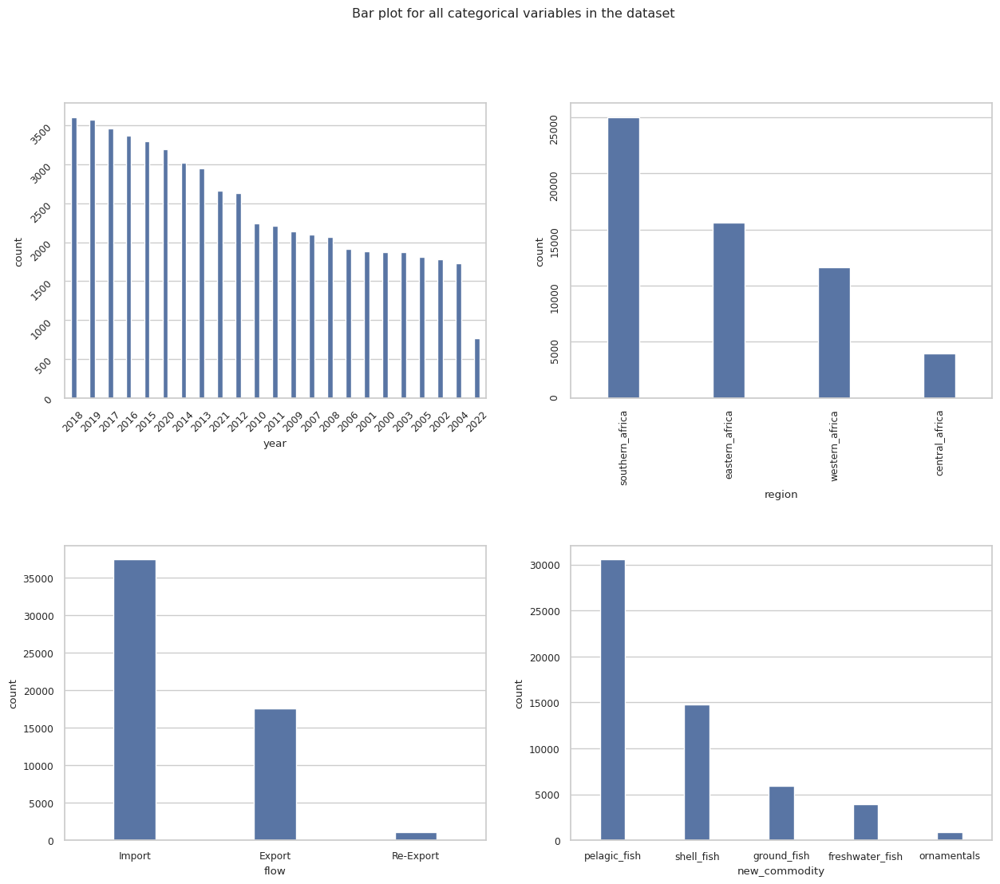

In [226]:
fig, axes = plt.subplots(2,2, figsize = (15, 12))
plt.subplots_adjust(hspace = 0.5)
fig.suptitle('Bar plot for all categorical variables in the dataset')
sns.set_palette("Set2")
sns.countplot(ax = axes[0, 0], x = 'year', data = rel_col,
              order = rel_col['year'].value_counts().index,width=0.3);
sns.countplot(ax = axes[0, 1], x = 'region', data = rel_col,
              order = rel_col['region'].value_counts().index,width=0.3);
sns.countplot(ax = axes[1, 0], x = 'flow', data = rel_col,
              order = rel_col['flow'].value_counts().index,width=0.3);
sns.countplot(ax = axes[1, 1], x = 'new_commodity', data = rel_col,
              order = rel_col['new_commodity'].value_counts().index,width=0.3);
axes[0][0].tick_params(labelrotation=45);
axes[0][1].tick_params(labelrotation=90);
#axes[2][2].tick_params(labelrotation=90);

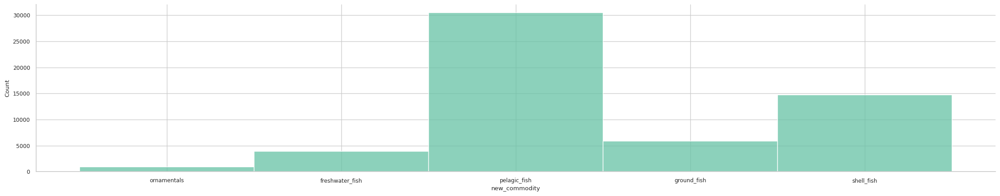

In [227]:
sns.displot(rel_col, x="new_commodity", height=4.5, aspect=5.0)
plt.show()

## EDA Bivariate Analysis

Bivariate Analysis helps to understand how variables are related to each other and the relationship between dependent and independent variables present in the dataset.

For Numerical variables, Pair plots and Scatter plots are widely been used to do Bivariate Analysis.

A Stacked bar chart can be used for categorical variables if the output variable is a classifier. Bar plots can be used if the output variable is continuous.

In [228]:
rel_col.head()

,country,region,year,flow,new_commodity,trade,quantity
0,Angola,southern_africa,2021,Import,ornamentals,1277.749,292.389
1,Angola,southern_africa,2021,Import,ornamentals,393.973,1036.657
2,Angola,southern_africa,2021,Import,freshwater_fish,31.673,40.000
3,Angola,southern_africa,2021,Export,pelagic_fish,12460.480,6251.000
4,Angola,southern_africa,2021,Import,pelagic_fish,2231.475,187.640


In [229]:
rel_col['flow'].unique()

array(['Import', 'Export', 'Re-Export'], dtype=object)

In [230]:
rel_col['region'].unique()

array(['southern_africa', 'western_africa', 'eastern_africa',
       'central_africa'], dtype=object)

In [231]:
rel_col['new_commodity'].unique()

array(['ornamentals', 'freshwater_fish', 'pelagic_fish', 'ground_fish',
       'shell_fish'], dtype=object)

In [232]:
rel_col['year'].unique()

array([2021, 2020, 2019, 2018, 2017, 2016, 2015, 2014, 2013, 2012, 2011,
       2010, 2009, 2007, 2008, 2006, 2005, 2004, 2003, 2002, 2001, 2000,
       2022])

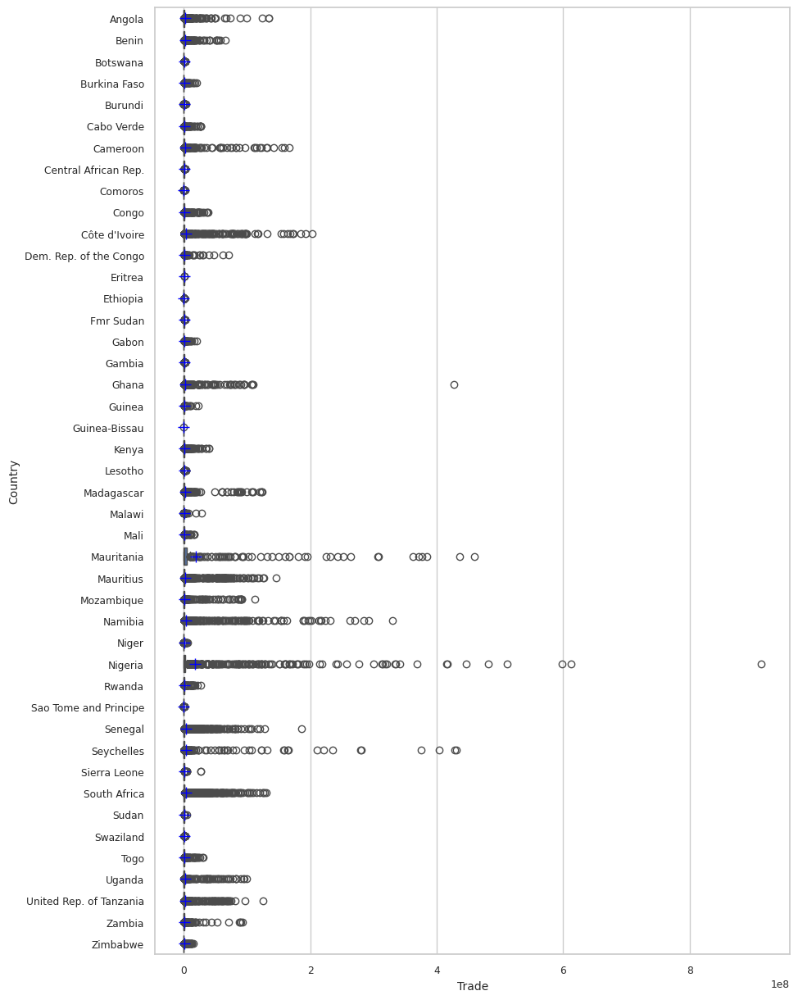

In [233]:
#count plot along y axis


sns.set(rc={'figure.figsize':(10,15)}, font_scale=0.8, style='whitegrid')

#sns.set(style="darkgrid")

sns.boxplot(x='trade',
            y='country',
            data=rel_col,
            showmeans=True,
            meanprops={"marker": "+",
                       "markeredgecolor": "blue",
                       "markersize": "10"})
plt.ylabel("Country", size=10)
plt.xlabel("Trade", size=10)



# Show the plot
plt.show()

## Mutivariate Analysis for Fish Trade

Commodity vs Region

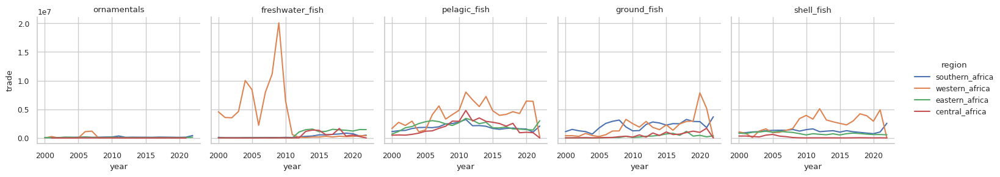

In [234]:
# Plotting total trade for each commodity between 2000-2023 for all regions.

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col, col='new_commodity', hue='region', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

# Save the figure
#g.savefig("facet_plot.png", dpi=1000, bbox_inches="tight")

# Download to your computer
#from google.colab import files
#files.download("facet_plot.png")

Region vs Commodity

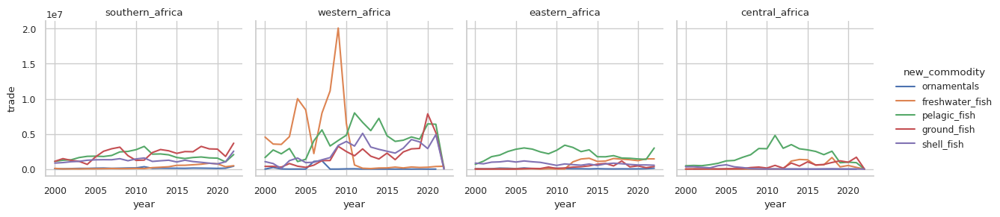

In [235]:
# Plotting total trade for each region between 2000-2023 for all species

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col, col='region', hue='new_commodity', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

Region vs Commodity-Import

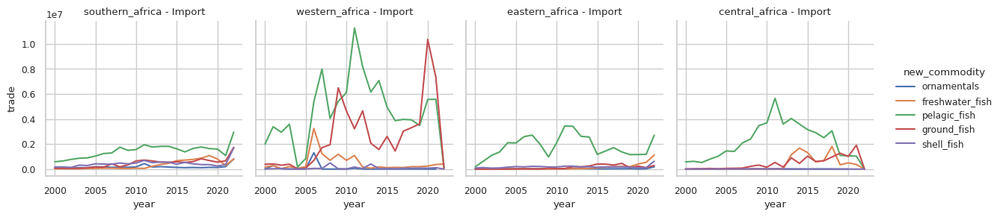

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 1000x1500 with 0 Axes>

In [236]:
# Subset for Import
df_import = rel_col[rel_col["flow"] == "Import"]

sns.set_style("whitegrid", {'axes.grid': True})
g = sns.FacetGrid(df_import, col='region', hue='new_commodity',
                  aspect=1, height=3.0, despine=True)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name} - Import")
g.add_legend()
g.tight_layout()
plt.show()

# Download plot
from google.colab import files

# Save figure with dpi
plt.savefig("trade_specie_region_flow_import.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("trade_specie_region_flow_import.png")

Region vs Commodity-Export

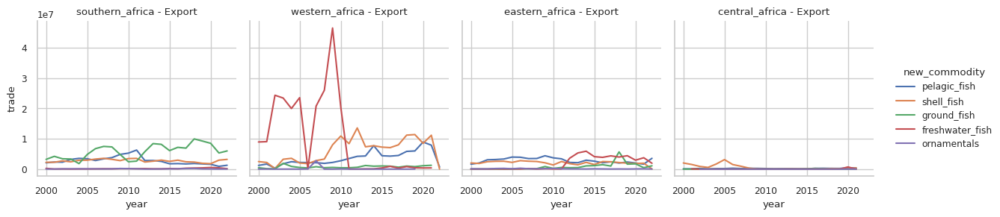

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 1000x1500 with 0 Axes>

In [237]:
# Subset for Export
df_export = rel_col[rel_col["flow"] == "Export"]

sns.set_style("whitegrid", {'axes.grid': True})
g = sns.FacetGrid(df_export, col='region', hue='new_commodity',
                  aspect=1, height=3.0, despine=True)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name} - Export")
g.add_legend()
g.tight_layout()
plt.show()

# Download plot
from google.colab import files

# Save figure with dpi
plt.savefig("trade_specie_region_flow_export.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("trade_specie_region_flow_export.png")

Region vs Commodity-Re-Export

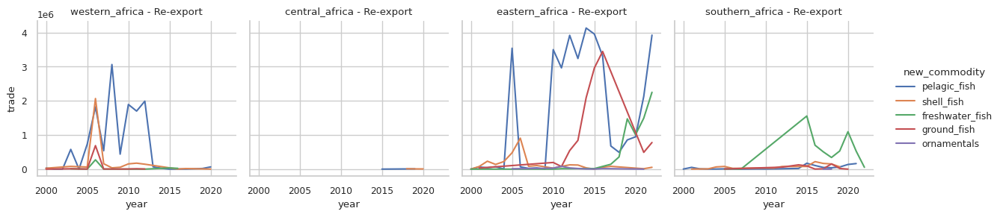

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 1000x1500 with 0 Axes>

In [238]:
# Subset for Re-export
df_reexport = rel_col[rel_col["flow"] == "Re-Export"]

sns.set_style("whitegrid", {'axes.grid': True})
g = sns.FacetGrid(df_reexport, col='region', hue='new_commodity',
                  aspect=1, height=3.0, despine=True)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name} - Re-export")
g.add_legend()
g.tight_layout()
plt.show()

# Download plot
from google.colab import files

# Save figure with dpi
plt.savefig("trade_specie_region_flow_re_export.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("trade_specie_region_flow_re_export.png")

Region vs Flow

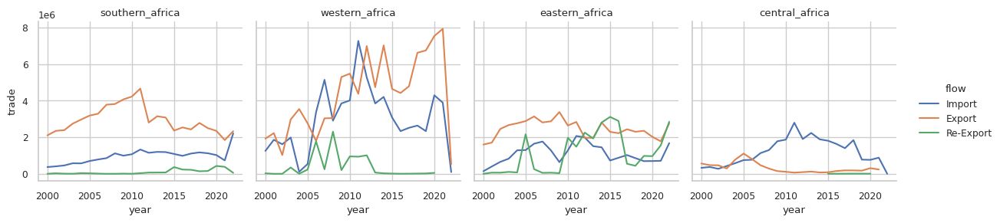

In [239]:
# Plotting total trade for each region between 2000-2023 for all flows

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col, col='region', hue='flow', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

Flow vs Region

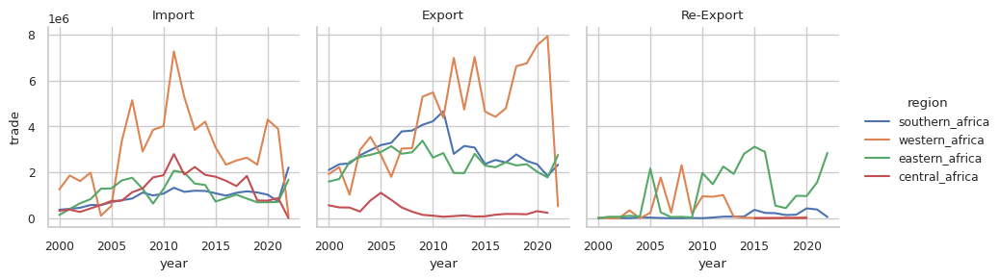

In [240]:
# Plotting total trade for each flow between 2000-2023 for all regions

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col, col='flow', hue='region', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

Commodity vs Flow

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

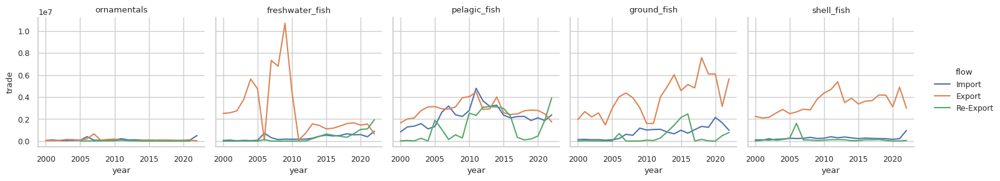

In [241]:
# Plotting total trade for each commodity between 2000-2023 for all flows

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col, col='new_commodity', hue='flow', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()


# Download plot
from google.colab import files
#files.download("trade_specie_flow_SSA.png", dpi)

# Save figure with dpi
plt.savefig("trade_specie_flow_SSA.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("trade_specie_flow_SSA.png")

Flow vs Commodity

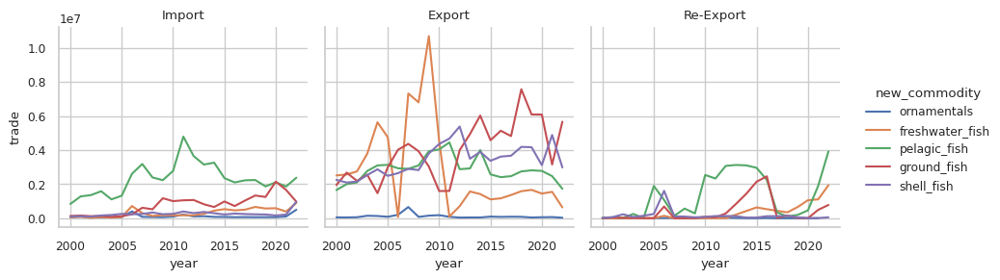

In [242]:
# Plotting total trade for each flow between 2000-2023 for all commodities

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col, col='flow', hue='new_commodity', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'trade', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

## Multivariate Analysis for Fish Quantity

In [243]:
rel_col2 = rel_col.copy()
rel_col2.head()
rel_col2["quantity_var"] = np.log1p(rel_col2["quantity"])


In [244]:
rel_col2.head()

,country,region,year,flow,new_commodity,trade,quantity,quantity_var
0,Angola,southern_africa,2021,Import,ornamentals,1277.749,292.389,5.681499
1,Angola,southern_africa,2021,Import,ornamentals,393.973,1036.657,6.944721
2,Angola,southern_africa,2021,Import,freshwater_fish,31.673,40.000,3.713572
3,Angola,southern_africa,2021,Export,pelagic_fish,12460.480,6251.000,8.740657
4,Angola,southern_africa,2021,Import,pelagic_fish,2231.475,187.640,5.239840


Commodity vs Region

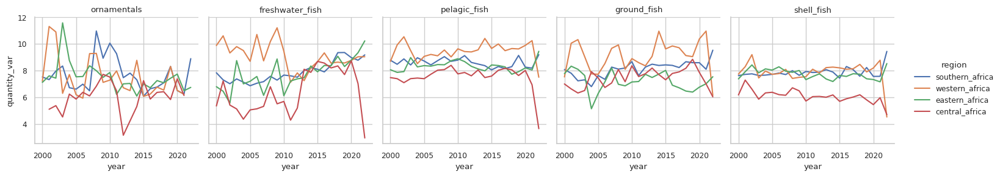

In [245]:
# Plotting total quantity for each commodity between 2000-2023 for all regions.

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col2, col='new_commodity', hue='region', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

Region vs Commodity

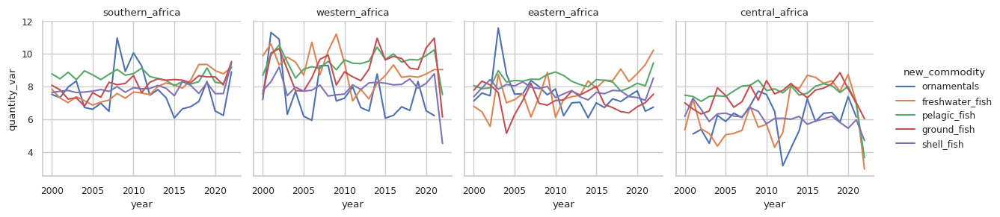

In [246]:
# Plotting total trade for each commodity between 2000-2023 for all regions.

sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col2, col='region', hue='new_commodity', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

Region vs Commodity-Import

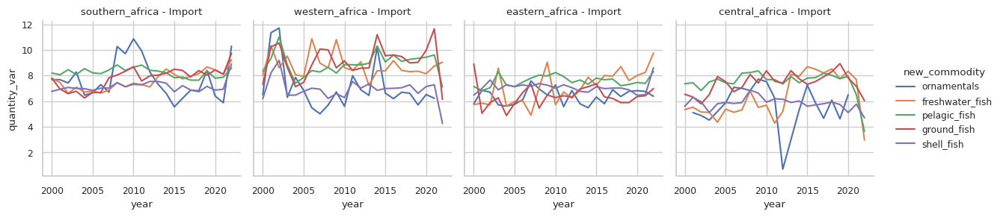

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 1000x1500 with 0 Axes>

In [247]:
# Subset for Import
df_import = rel_col2[rel_col2["flow"] == "Import"]

sns.set_style("whitegrid", {'axes.grid': True})
g = sns.FacetGrid(df_import, col='region', hue='new_commodity',
                  aspect=1, height=3.0, despine=True)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name} - Import")
g.add_legend()
g.tight_layout()
plt.show()

# Download plot
from google.colab import files

# Save figure with dpi
plt.savefig("qty_specie_region_flow_import.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("qty_specie_region_flow_import.png")

Region vs Commodity-Export

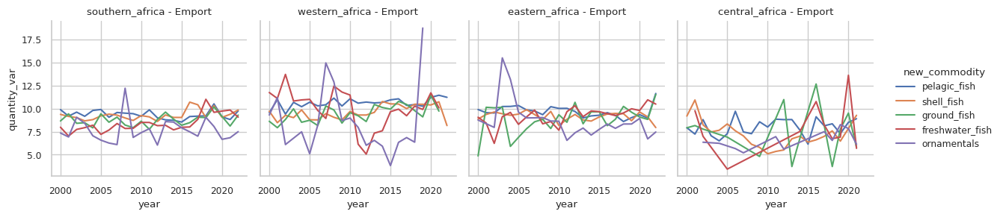

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 1000x1500 with 0 Axes>

In [248]:
# Subset for Import
df_import = rel_col2[rel_col2["flow"] == "Export"]

sns.set_style("whitegrid", {'axes.grid': True})
g = sns.FacetGrid(df_import, col='region', hue='new_commodity',
                  aspect=1, height=3.0, despine=True)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name} - Emport")
g.add_legend()
g.tight_layout()
plt.show()

# Download plot
from google.colab import files

# Save figure with dpi
plt.savefig("qty_specie_region_flow_export.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("qty_specie_region_flow_export.png")

Region vs Commodity-Re-Export

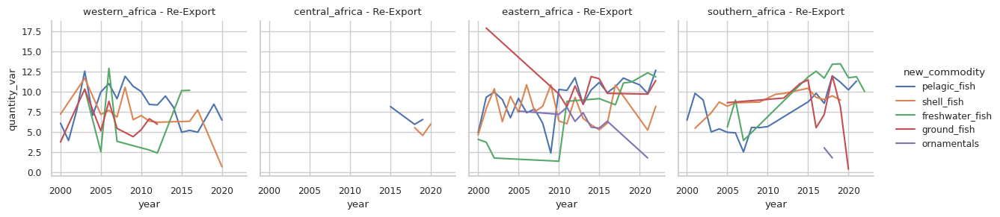

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<Figure size 1000x1500 with 0 Axes>

In [249]:
# Subset for Import
df_import = rel_col2[rel_col2["flow"] == "Re-Export"]

sns.set_style("whitegrid", {'axes.grid': True})
g = sns.FacetGrid(df_import, col='region', hue='new_commodity',
                  aspect=1, height=3.0, despine=True)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name} - Re-Export")
g.add_legend()
g.tight_layout()
plt.show()

# Download plot
from google.colab import files

# Save figure with dpi
plt.savefig("qty_specie_region_flow_re_export.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("qty_specie_region_flow_re_export.png")

Region vs Flow

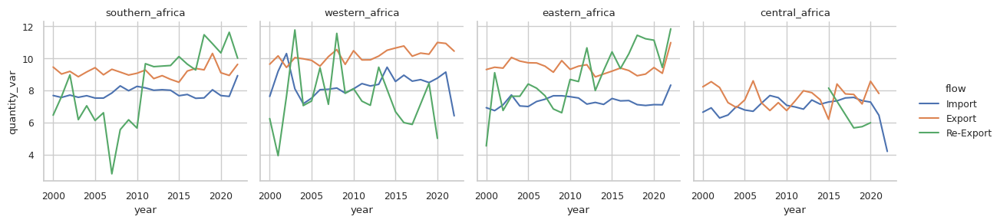

In [250]:
sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col2, col='region', hue='flow', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

Flow vs Region

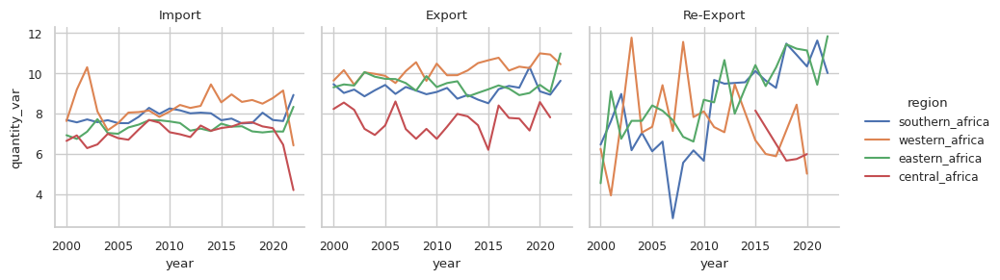

In [251]:
sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col2, col='flow', hue='region', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

Commodity vs Flow

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

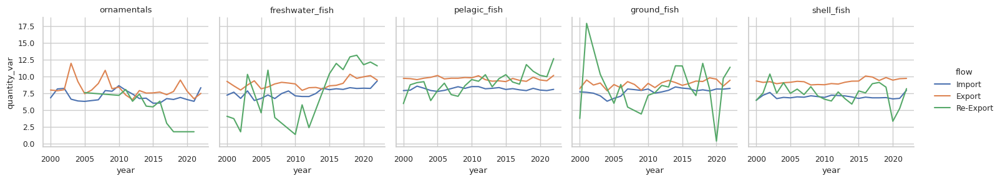

In [252]:
sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col2, col='new_commodity', hue='flow', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

# Download plot
from google.colab import files
#files.download("trade_specie_flow_SSA.png", dpi)

# Save figure with dpi
plt.savefig("qty_specie_flow_SSA.png", dpi=2000, bbox_inches="tight")

# Download file
files.download("qty_specie_flow_SSA.png")

Flow vs Commodity

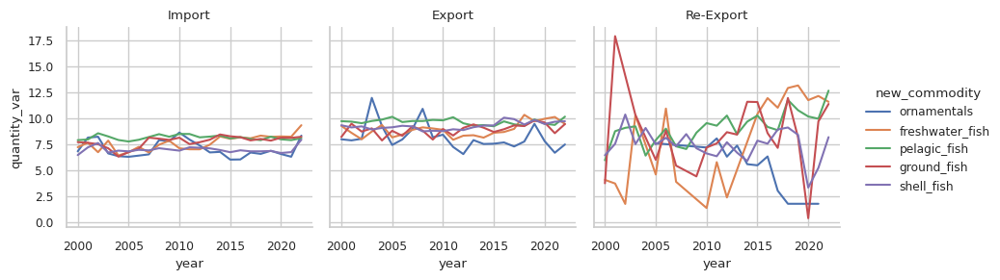

In [253]:
sns.set_style("whitegrid", {'axes.grid' : True})
g = sns.FacetGrid(rel_col2, col='flow', hue='new_commodity', aspect=1, height=3.0, despine=True,)
g.map_dataframe(sns.lineplot, 'year', 'quantity_var', ci=None)
g.set_titles(col_template="{col_name}")
g.add_legend()
g.tight_layout()

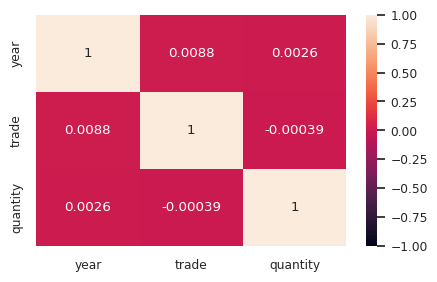

In [254]:
plt.figure(figsize=(5, 3))
dat = rel_col[['year', 'trade', 'quantity']]
sns.heatmap((dat).corr(), annot = True, vmin = -1, vmax = 1)
plt.show()

In [255]:
rel_col.head()

,country,region,year,flow,new_commodity,trade,quantity
0,Angola,southern_africa,2021,Import,ornamentals,1277.749,292.389
1,Angola,southern_africa,2021,Import,ornamentals,393.973,1036.657
2,Angola,southern_africa,2021,Import,freshwater_fish,31.673,40.000
3,Angola,southern_africa,2021,Export,pelagic_fish,12460.480,6251.000
4,Angola,southern_africa,2021,Import,pelagic_fish,2231.475,187.640


# 2. Explore Pandas Profiling

In [256]:
pip install ydata-profiling

In [257]:
from ydata_profiling import ProfileReport

profile = ProfileReport(rel_col, title="Profiling Report", minimal=True)
#profile.to_file(output_file='output.html')
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 7/7 [00:00<00:00,  9.68it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Machine Learning Model Development
Implemented on HPC due to long computation time for hyperparameter optimization

In [258]:
new_df = rel_col.drop(['country'],axis=1)
new_df.head()

,region,year,flow,new_commodity,trade,quantity
0,southern_africa,2021,Import,ornamentals,1277.749,292.389
1,southern_africa,2021,Import,ornamentals,393.973,1036.657
2,southern_africa,2021,Import,freshwater_fish,31.673,40.000
3,southern_africa,2021,Export,pelagic_fish,12460.480,6251.000
4,southern_africa,2021,Import,pelagic_fish,2231.475,187.640


In [259]:
# Using One-Hot encoding in category_encoder package to transform region and new_commodity columns to numerical variables.

encoder = ce.OneHotEncoder(cols=['region','flow','new_commodity'], use_cat_names=True)
new_df2 = encoder.fit_transform(new_df)
new_df2.head()

,region_southern_africa,region_western_africa,region_eastern_africa,region_central_africa,year,flow_Import,flow_Export,flow_Re-Export,new_commodity_ornamentals,new_commodity_freshwater_fish,new_commodity_pelagic_fish,new_commodity_ground_fish,new_commodity_shell_fish,trade,quantity
0,1,0,0,0,2021,1,0,0,1,0,0,0,0,1277.749,292.389
1,1,0,0,0,2021,1,0,0,1,0,0,0,0,393.973,1036.657
2,1,0,0,0,2021,1,0,0,0,1,0,0,0,31.673,40.000
3,1,0,0,0,2021,0,1,0,0,0,1,0,0,12460.480,6251.000
4,1,0,0,0,2021,1,0,0,0,0,1,0,0,2231.475,187.640


In [260]:
#Separate feature vector from label to check class distribution
X = new_df2.drop(['trade'], axis=1)
y = new_df2[['trade']]

## We drop replace the "trade" column with "quantity" to perform fish quantity prediction

In [261]:
# Split the dataset into 70% Training set and 30% Test set-------------------------
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 42)

# Performing feature normalization or standardization-----------------------------------
# The range of values for the attributes are almost of the same range. Standardization will improve the data
# variability and mean.
scale = StandardScaler() # The robust scaler standardize the data and also deals with outliers in the data
X_train = scale.fit_transform(X_train)
X_test = scale.transform(X_test)

## Hyperparameter Tuning using random search

In [ ]:
print('\n')
# MODEL DEVELOPMENT BEGINS
print('# MODEL DEVELOPMENT BEGIN')
# Cross validation of 10 folds and 5 runs
cv_method = RepeatedKFold(n_splits=10, n_repeats=5, random_state=42)

# Hyperparameter Optimization using RandomSearch and CrossValidation to get the best model hyperparamters
# Linear regression and ridge regression
LR = LinearRegression() #'loss': ['linear', 'square']}


# kNN regression
nearest_neighbour = KNeighborsRegressor()
# Create a dictionary of KNN parameters
# K values between 1 and 9 are used to avoid ties and p values of 1 (Manhattan), 2 (Euclidean), and 5 (Minkowski)
param_kNN = {'n_neighbors': [1,3,5,7,9],'p':[1,2,5]} # Distance Metric: Manhattan (p=1), Euclidean (p=2) or
# Minkowski (any p larger than 2). Technically p=1 and p=2 are also Minkowski distances.
# Define the kNN model using RandomSearch and optimize accuracy
kNN_grid = RandomizedSearchCV(nearest_neighbour,param_kNN,scoring='r2',cv=cv_method)
kNN_grid.fit(X_train,y_train)
# Print the best parameter values for KNN
print('kNN Best Parameter values =',kNN_grid.best_params_)
#kNN = KNeighborsClassifier(**kNN_grid.best_params_)
kNN = kNN_grid.best_estimator_


# Support Vector Regression
SVR_model = SVR()
# Create a dictionary of SVM hyperparameters
# Parameter space for rbf kernels
params_SVR = {'kernel':['rbf'],'C':np.linspace(0.1,1.0),
              'gamma':['scale','auto']}

# Using Random Search to explore the best parameter for the a SVM model
SVR_Grid = RandomizedSearchCV(SVR_model, params_SVR,scoring='r2',cv=cv_method)
# Fitting the parameterized model
SVR_Grid.fit(X_train,y_train)
# Print the best parameter values
print('SVC Best Parameter Values:', SVR_Grid.best_params_)
SVR = SVR_Grid.best_estimator_


# Randomforest
RF2 = RandomForestRegressor()
params_RF = {'n_estimators': [10,15,20,25,30],
               'max_depth': [10,15,20,25,30]}
RF_Grid = RandomizedSearchCV(RF2, params_RF,scoring='r2',cv=cv_method)
# Fitting the parameterized model
RF_Grid.fit(X_train,y_train)

# Print the best parameter values
print('RF Best Parameter Values:', RF_Grid.best_params_)
RF = RF_Grid.best_estimator_


#Boosting regressor
Bag = BaggingRegressor()
params_Bag = {'n_estimators':[10,15,20,25,30]}
Bag_Grid = RandomizedSearchCV(Bag, params_Bag,scoring='r2',cv=cv_method)
# Fitting the parameterized model
Bag_Grid.fit(X_train,y_train)

# Print the best parameter values
print('Bagging Best Parameter Values:', Bag_Grid.best_params_)
BAG = Bag_Grid.best_estimator_


#Adaboost regressor
ADA2 = AdaBoostRegressor()
params_ADA = {'n_estimators': [10,15,20,25,30],
               'learning_rate':np.linspace(0.1,1.0)}
ADA_Grid = RandomizedSearchCV(ADA2, params_ADA,scoring='r2',cv=cv_method)
# Fitting the parameterized model
ADA_Grid.fit(X_train,y_train)

# Print the best parameter values
print('RF Best Parameter Values:', ADA_Grid.best_params_)
ADA = ADA_Grid.best_estimator_

print('\n')




# MODEL DEVELOPMENT BEGIN


## Model Training and Evaluation

In [ ]:
# get a list of models to evaluate
def get_models():
    models = dict()
    models['LR'] = LR
    models['kNN'] = kNN
    models['SVR'] = SVR
    models['RF'] = RF
    models['Bagging'] = BAG
    models['AdaBoost'] = ADA

    return models


# evaluate a given model using cross-validation
def evaluate_model(model, X_train, y_train):
    scores = cross_val_score(model, X_train, y_train, scoring='r2', cv=cv_method, n_jobs=-1)
    return scores


# get the models to evaluate
models = get_models()
# evaluate the models and store results
test_results, names, = list(), list()
print('Mean Accuracy and Std Dev of each model on test set:----------------------------------')
for name, model in models.items():
    scores = evaluate_model(model, X_test, y_test)
    test_results.append(scores)
    names.append(name)
    print('>%s %.5f' % (name, mean(scores)),u"\u00B1", '%.5f' % std(scores))
#test_dict = dict(zip(names, test_results))
#test_dict = pd.DataFrame(test_dict)
print('\n')


print('Mean Accuracy and Std Dev of each model on train set:-----------------------------')
train_results, names, = list(), list()
for name, model in models.items():
    # evaluate the model
    scores = evaluate_model(model, X_train, y_train)
    # store the results
    train_results.append(scores)
    names.append(name)
    # summarize the performance along the way
    print('>%s %.5f' % (name, mean(scores)), u"\u00B1", '%.5f' % std(scores))
#train_dict = dict(zip(names, train_results))
#train_dict = pd.DataFrame(train_dict)
print('\n')


fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(13, 5))
fig.suptitle('Testing and Training Performance of Models', fontsize=12)
fig.tight_layout(pad=4.0)
ax1.boxplot(test_results, labels=names, showfliers=False)
# Add a horizontal grid to the plot, but make it very light in color
# so we can use it for reading data values but not be distracting
ax1.yaxis.grid(True, linestyle='-', which='major', color='lightgrey',
               alpha=0.5)
ax1.set_axisbelow=True
ax1.set_xlabel("Models", fontsize=12)
ax1.set_ylabel("Testing Accuracy", fontsize=12)

ax2.boxplot(train_results, labels=names, showfliers=False)
ax2.yaxis.grid(True, linestyle='-', which='major', color='lightgrey',
               alpha=0.5)

ax2.set_axisbelow=True
ax2.set_xlabel("Models", fontsize=12)
ax2.set_ylabel("Training Accuracy", fontsize=12)
plt.show()


print('\n')
for name, model in models.items():
    #fit the model
    model.fit(X_train, y_train)
    # the product on the test set
    y_pred = model.predict(X_test)
    # evaluate the models
    mse_test = mean_squared_error(y_test, y_pred)
    root_mse_test = np.sqrt(mse_test)
    r2_test = r2_score(y_test, y_pred)
    print('Performance Result of', name, '--------------------------------------------------------------------')
    print(name, 'root mean squared error of test set:', root_mse_test)
    print(name, 'r_squared coefficient of test set:', r2_test)

    y_pred_train = model.predict(X_train)
    # evaluate the models
    mse_train = mean_squared_error(y_train, y_pred_train)
    root_mse_train = np.sqrt(mse_train)
    r2_train = r2_score(y_train, y_pred_train)
    print('Performance Result of', name, '--------------------------------------------------------------------')
    print(name, 'root mean squared error of train set:', root_mse_train)
    print(name, 'r_squared coefficient of train set:', r2_train)
